# **<h1><center> Production EDA </center></h1>**

### Description: 
- With Python, we will generate some high-level views on oil production from wells in the Williston Basin of North Dakota. The performance of these wells are governed by two primary sets of factors:

1) **Engineering:**
    - Factors under our control. These include depth and length of the well, where we place the well in the reservoir, how we stimulate the well (pumping fluid and proppant in to create fractures), and how closely we place multiple wells together (too close and they compete with one another, too far and we risk leaving resource behind). These features are best viewed in tabular format.
    

2) **Geologic:**
    - Factors outside of our control but measurable. Parameters such as pressure, thickness, porosity/permeability, saturations (oil/gas/water), stress, natural fracturing, etc. The primary geologic drivers change for different parts of the basin and are very much a topic of interpretation. These variables are best viewed spatially on a map, not in tabular format.


- We don’t have any traditional geologic variables to work with here, nor do we have the information on how the wells were stimulated. We will have to be creative and work with what we have to generate features that approximate this missing data!

### Data Context:
- The data we are working with here was scraped from a webpage and stored in two CSV files. For those unfamiliar with these oil and gas data types, I hope to provide some context. We will be working with 2 tables:

1) **Header Table**
    - Contains general information about a well such as depth and location. It also contains the UWI (unique well identifier). There is a row for every well, leaving us with ~15,000 records.

2) **Production Table (Time-Series)**
    - Wells produce oil, water, and gas over time. This is our time-series data, which is why it is held in a separate table. Each of our ~15,000 wells have multiple records in this table, making is significantly larger at around 1.1 million rows. This table contains the UWI, the time stamp, the number of days that well actually flowed for that month, and the coinciding volumes for oil/water/gas.



# <center> ---------------------------------------------------------- </center>

## Import Packages

In [1]:
# Base Packages
import numpy as np
import pandas as pd
from statistics import mean 

# Plotting Packages
import folium
import plotly.express as px
import plotly.graph_objects as go
import branca.colormap as cm

# Misc Settings
pd.options.display.float_format = '{:.3f}'.format
pd.set_option("display.max_rows",1000)
pd.set_option('display.max_columns', None)
pd.options.display.precision = 1

## Import Production data

In [21]:
# Read in production data 
df_production = pd.read_csv(r"prod.csv")

# Trim to reasonable values
df_production = df_production[df_production['WOR'].between(0.1,10)]
df_production = df_production[df_production['Days'] > 0]

# Set index
df_production.set_index('UWI',inplace=True)

# Make the Date column a datetime object (like a timestamp)
df_production['Date'] = pd.to_datetime(df_production['Date'], infer_datetime_format=True)

# View results (first row and summary table)
display(df_production.head(1))
df_production.describe().transpose()

,Date,Days,Oil_nrm,Water_nrm,Gas_nrm,Fluid_nrm,WOR,GOR
UWI,,,,,,,,
33007011630000,1993-10-01,31.000,1721.787,375.043,22775.315,2096.829,0.218,13.228


,count,mean,std,min,25%,50%,75%,max
Days,1085078.000,27.823,5.941,1.000,28.000,30.000,31.000,31.000
Oil_nrm,1084979.000,3684.722,10054.580,0.841,1043.735,1948.888,3874.727,3446710.526
Water_nrm,1084979.000,3477.668,9772.124,0.676,858.659,1700.809,3505.937,2614736.842
Gas_nrm,1084979.000,6126.928,27362.431,0.000,1360.652,2841.112,6000.657,7422894.737
Fluid_nrm,1084979.000,7162.390,18772.159,1.682,2195.874,3860.074,7391.146,5155263.158
WOR,1085078.000,1.210,1.123,0.100,0.479,0.894,1.554,10.000
GOR,1085078.000,1.946,7.214,0.000,0.888,1.386,2.228,4997.000


## Import Header data

In [22]:
# Read in header data 
df_header = pd.read_csv(r"header.csv")

# Set Index, cast dates
df_header.set_index('UWI',inplace=True)
df_header[['Completion_Date','Spud_Date']] = df_header[['Completion_Date','Spud_Date']].apply(pd.to_datetime, errors='coerce')

# View results (first row and summary table)
print(df_header.shape)
df_header.sample(3)

(14816, 25)


,Well_Name,Latitude,Longitude,Current_Operator,Completion_Date,Total_Depth,Spud_Date,Perf_Interval,Cum_Oil,Cum_Gas,Cum_Water,Vintage_Year,Top_Perf,Bottom_Perf,Perforated_Length,Section,Township,Range,Block,12m_Oil_nrm_cum,12m_WOR,24m_Oil_nrm_cum,24m_WOR,36m_Oil_nrm_cum,36m_WOR
UWI,,,,,,,,,,,,,,,,,,,,,,,,,
33025019350000,LK-LITTLE CHASE CREEK 147-97-2116H-2,47.531,-103.045,"HESS BAKKEN INVESTMENTS II, LLC",2013-06-16,20585,2012-11-30,11636-20585,129997,198862,89388,2013.000,11636.000,20585.000,8949.000,21,147,97,14797,57657.000,0.629,80637.000,0.592,97092.000,0.958
33105023040000,STROMME FAMILY TRUST 157-101-11C-2-1H,48.430,-103.706,"BRUIN E&P OPERATING, LLC",2012-05-14,20377,2012-03-10,10387-20377,142166,142493,283477,2012.000,10387.000,20377.000,9990.000,14,157,101,157101,42851.000,1.637,70880.000,1.596,87961.000,1.880
33105033870000,CPEUSC MATILDA MAY 32-29-158-100,48.461,-103.631,CRESCENT POINT ENERGY U.S. CORP.,2014-11-02,19612,2014-07-16,10317-19612,151993,144226,183395,2014.000,10317.000,19612.000,9295.000,32,158,100,158100,85910.000,1.241,116237.000,1.423,131575.000,0.773


## High-Level Data QC
- Lets look at production

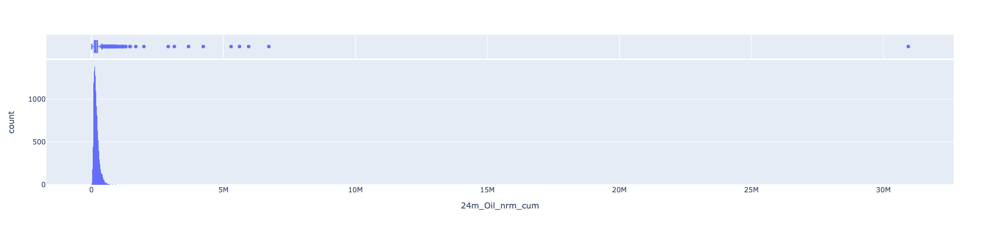

In [23]:
# Look at distribution of performance
px.histogram(df_header, x='24m_Oil_nrm_cum', 
             marginal = 'box', 
             height = 400, width = 700)

In [24]:
# Eliminate unreasonable values
df_header = df_header[(df_header['24m_Oil_nrm_cum'] < 800000) | (df_header['24m_Oil_nrm_cum'].isnull())]
df_header = df_header[(df_header['24m_WOR'] < 10) | (df_header['24m_WOR'].isnull())]

# <center> ------------------------- Mapping ------------------------- </center>

## What does the basin look like?
- Here we will plot our wells on a map, colored by the depth of the top perforation. The top perf on a well is typically within ~100’ of entering the formation, with this in mind we can use this perf depth as a proxy for formation depth.

In [6]:
# Create DataFrame of values to plot
df_structure = df_header[df_header['Top_Perf'] > 9000]

# Create map
map_visual = folium.Map(location=(df_structure['Latitude'].mean(), df_structure['Longitude'].mean()),
                        zoom_start = 8, width = 500, height = 700)

# Specify feature to color by
color_by = 'Top_Perf'

# Create color map
colorbar = cm.LinearColormap(colors=['black','gray','green','yellow','orange','red','darkviolet'], vmin=9000, vmax= 11600)

# Loop through each well in DataFrame, create circle, add to map
for uwi in df_structure.index:
    folium.Circle(
                    location=[df_structure.loc[uwi]['Latitude'], df_structure.loc[uwi]['Longitude']],
                    radius = 1100,
                    fill = True,
                    fill_opacity = 1,
                    color = colorbar(df_structure.loc[uwi][color_by])
                ).add_to(map_visual)
    
# Add colorbar
colorbar.caption = 'Top_Perf'
map_visual.add_child(colorbar)

# View
map_visual

- Looking at our map above it appears our assumption holds! The Williston basin has one structural feature that stands out from the others, the Nesson Anticline!

## What are the most prolific areas?

In [7]:
# Create DataFrame of values to plot
df_prodmap = df_header[df_header['24m_Oil_nrm_cum'].between(1,800000)]

# Create map
map_visual = folium.Map(location=(df_prodmap['Latitude'].mean(), df_prodmap['Longitude'].mean()),
                        zoom_start = 8, width = 500, height = 700)

# Specify feature to color by
color_by = '24m_Oil_nrm_cum'

# Create color map
colorbar = cm.LinearColormap(colors=['black','gray','green','yellow','orange','red','darkviolet'], vmin=0, vmax= 500000)

# Loop through each well in DataFrame, create circle, add to map
for uwi in df_prodmap.index:
    folium.Circle(
        location=[df_prodmap.loc[uwi]['Latitude'], df_prodmap.loc[uwi]['Longitude']],
        radius = 1100,
        fill = True,
        fill_opacity = 1,
        color = colorbar(df_prodmap.loc[uwi][color_by])
    ).add_to(map_visual)
    
# Add colorbar
colorbar.caption = 'Top_Perf'
map_visual.add_child(colorbar)

# View
map_visual

- Looking at this map, you could argue there are some trends in some areas, but its difficult to see
- There are many other factors at play here other than the geology
    - These are our engineering factors

## What are the most prolific blocks?

##### Group by Blocks
- Find mean oil and WOR

In [8]:
# Create a new dataframe to hold data groupbed by block
df_blocks = pd.DataFrame()

# Use the Pandas GroupBy method to aggregate data by block
df_blocks['num_wells_block'] = df_header.groupby('Block')['Well_Name'].count()
df_blocks['12m_oil_cum_block'] = df_header.groupby('Block')['12m_Oil_nrm_cum'].mean().astype(int)
df_blocks['12m_WOR_mean_block'] = df_header.groupby('Block')['12m_WOR'].mean()
df_blocks['24m_oil_mean_block'] = df_header.groupby('Block')['24m_Oil_nrm_cum'].mean().astype(int)
df_blocks['24m_WOR_mean_block'] = df_header.groupby('Block')['24m_WOR'].mean()

# Sort the dataframe by production
df_blocks.sort_values('24m_oil_mean_block',inplace=True, ascending=False)

# View Results
df_blocks.head()

,num_wells_block,12m_oil_cum_block,12m_WOR_mean_block,24m_oil_mean_block,24m_WOR_mean_block
Block,,,,,
15390,74,321526,0.347,457503,0.470
145101,5,254632,0.027,398787,0.006
15490,82,258183,0.342,375836,0.538
15094,105,266044,0.653,339532,0.606
15291,123,233087,0.432,337344,0.388


### Add Block aggregated metrics to wells (with lat/longs) for a plot

In [9]:
df_header_blocks = df_header.merge(df_blocks, left_on = 'Block', right_index=True)

# Map

In [10]:
df_map = df_header_blocks.copy()

# Create map
map_visual = folium.Map(location=(df_map['Latitude'].mean(), df_map['Longitude'].mean()), zoom_start = 8, width = 500, height = 700)

# Specify feature to color by
color_by = '24m_oil_mean_block'

# Create color map
colorbar = cm.LinearColormap(colors=['black','gray','green','yellow','orange','red','darkviolet'], vmin=60000, vmax= 400000)

# Loop through each well in DataFrame, create circle, add to map.
for uwi in df_map.index:
    folium.Circle(
        location=[df_map.loc[uwi]['Latitude'], df_map.loc[uwi]['Longitude']],
        radius = 1250,
        popup = df_map.loc[uwi]['Block'],
        fill = True,
        fill_opacity = 1,
        color = colorbar(df_map.loc[uwi][color_by])
    ).add_to(map_visual)
    
# Add colorbar
colorbar.caption = 'Top_Perf'
map_visual.add_child(colorbar)

# View
map_visual

# Production Box Plots

### Cumulative Oil

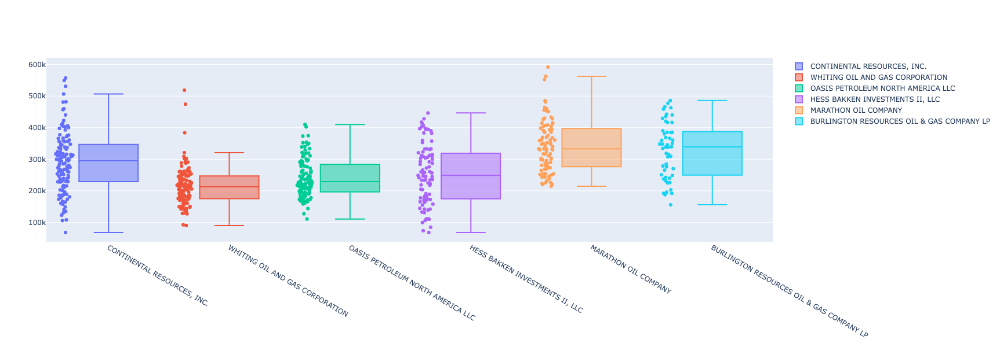

In [11]:
# Make copies of dataframes for plotting
df_prod = df_production.copy()
df_head = df_header.copy()

# Filter the DataFrames
df_head = df_head[df_head['Vintage_Year'] == 2018]

# Get the top 6 operators
top_6_operators = df_head['Current_Operator'].value_counts().keys()[:6]

# Create and populate figure
fig = go.Figure(layout={'height':600,'width':1100})

for operator in top_6_operators:
    fig.add_trace(go.Box(y = df_head[df_head['Current_Operator'] == operator]['24m_Oil_nrm_cum'], name=operator))

fig.update_traces(boxpoints='all', jitter= 0.3 )

fig

### WOR

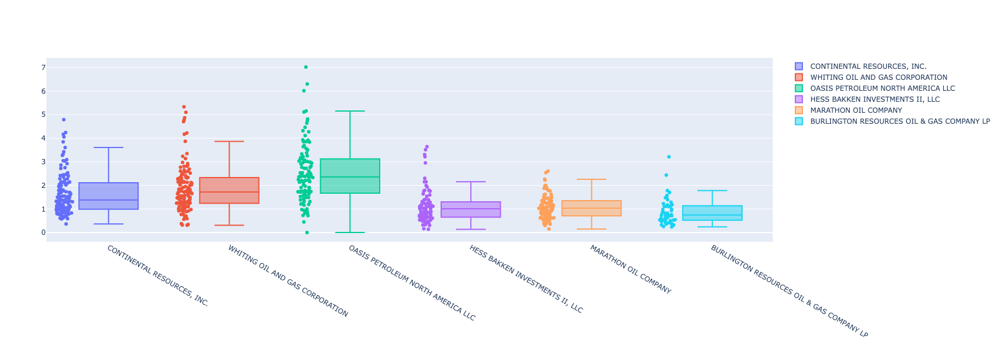

In [12]:
df_prod = df_production.copy()
df_head = df_header.copy()

df_head = df_head[df_head['Vintage_Year'] == 2018]

top_6_operators = df_head['Current_Operator'].value_counts().keys()[:6]

fig = go.Figure(layout={'height':600,'width':1100})


for operator in top_6_operators:
    fig.add_trace(go.Box(y = df_head[df_head['Current_Operator'] == operator]['24m_WOR'], name=operator))

fig.update_traces(boxpoints='all', jitter= 0.3 )
fig

# <center> ------------------------- Plotting production Streams ------------------------- </center>

## Define STREAM PLOT Function

In [13]:
def STREAM_PLOT(dataframe, production_dataframe, material, width, height, variable_dict = {'0-99999999':None}, rate_cum = 0, averages = 0, cumulative = 1,
                variable = df_header.select_dtypes(include=['float64']).iloc[:,0].name):
    
    fig = go.Figure(layout={'height':height,'width':width})
    
    if averages == 1:
        fig.update_layout(xaxis_title="Producing Days")
        for item in variable_dict.keys():
            low = float(item.split('-')[0])
            high = float(item.split('-')[1]) 
            df_temp = dataframe[dataframe[variable].between(low,high)]
            if len(df_temp) >= 1:     
                
                if material in ['WOR','GOR']:
                    average_list = []
                    for m in [i for i in range(1,27,1)]:
                        prod_list = []
                        for uwi in df_temp.index:  
                            try:
                                cum_day_list = production_dataframe.loc[uwi,'Days'].cumsum()
                                if m * 30.4 < max(cum_day_list):                                              
                                    rate_prod_list = production_dataframe.loc[uwi,material]
                                    prod_list.append(np.interp( m*30.4 , cum_day_list , rate_prod_list)) 
                                    name = f"Monthly {material}"
                            except: None
                        try:
                            average_list.append(mean(prod_list))
                        except: None
                    fig.update_layout(yaxis_title=name)
                    fig.add_trace(go.Scatter(x=[i*30.4 for i in range(1,27,1)], y=average_list, mode='lines',name=f'{item} Average', line=dict(color=variable_dict[item], width=6)))

                elif rate_cum == 0:        
                    average_list = []
                    for m in [i for i in range(1,27,1)]:
                        prod_list = []
                        for uwi in df_temp.index:  
                            try:
                                cum_day_list = production_dataframe.loc[uwi,'Days'].cumsum()
                                if m * 30.4 < max(cum_day_list):
                                    if cumulative == 1:
                                        cum_prod_list = production_dataframe.loc[uwi,material].cumsum()
                                        prod_list.append(np.interp( m*30.4 , cum_day_list , cum_prod_list))
                                        name = f"Cumulative {material} bbl"
                                    else:                 
                                        rate_prod_list = production_dataframe.loc[uwi,material]
                                        fig.update_yaxes(type='log')  
                                        prod_list.append(np.interp( m*30.4 , cum_day_list , rate_prod_list)) 
                                        name = f"Monthly {material} bbl"
                            except:None
                        try:
                            average_list.append(mean(prod_list))
                        except:None
                    fig.update_layout(yaxis_title =name)
                    fig.add_trace(go.Scatter(x=[i*30.4 for i in range(1,27,1)], y=average_list, mode='lines',name=f'{item} Average', line=dict(color=variable_dict[item], width=6)))
            print(item,f'{len(df_temp)} wells')
            
    else:
        for item in variable_dict.keys():
            low = float(item.split('-')[0])
            high = float(item.split('-')[1]) 
            df_temp = dataframe[dataframe[variable].between(low,high)]
            if len(df_temp) >= 1:
                
                if material in ['WOR','GOR']:
                    for uwi in df_temp.index:
                        try:
                            day_list = production_dataframe.loc[uwi,'Days'].cumsum()
                            prod_list = production_dataframe.loc[uwi,material]
                            name = f"Monthy {material} Rate"
                            fig.add_trace(go.Scatter(x=day_list, y=prod_list, mode='lines',name=f"{dataframe.loc[uwi,'Well_Name']} ({dataframe.loc[uwi,'Current_Operator']})", line=dict(width=2,color=variable_dict[item])))
                        except: None
                    fig.update_layout(xaxis_title="Producing Days", yaxis_title=name)

                elif rate_cum == 1:        
                    for uwi in df_temp.index:
                        try:
                            rate_list = production_dataframe.loc[uwi,material]
                            cum_list = production_dataframe.loc[uwi,material].cumsum()
                            fig.update_yaxes(type='log')  
                            fig.add_trace(go.Scatter(x=cum_list, y=rate_list, mode='lines',name=f"{dataframe.loc[uwi,'Well_Name']} ({dataframe.loc[uwi,'Current_Operator']})", line=dict(width=2,color=variable_dict[item])))
                            fig.update_layout(xaxis_title= material+' Cum', yaxis_title =material+' Rate')
                        except: None

                elif rate_cum == 0:       
                    fig.update_layout(xaxis_title="Producing Days")
                    for uwi in df_temp.index:
                        try:
                            day_list = production_dataframe.loc[uwi,'Days'].cumsum()
                            if cumulative == 1:
                                prod_list = production_dataframe.loc[uwi,material].cumsum()
                                name = f"Cumulative {material} bbl"
                            else:
                                prod_list = production_dataframe.loc[uwi,material]
                                name = f"Monthy {material} bbl"
                                fig.update_yaxes(type='log')  
                            fig.add_trace(go.Scatter(x=day_list, y=prod_list, mode='lines',name=f"{dataframe.loc[uwi,'Well_Name']} ({dataframe.loc[uwi,'Current_Operator']})", line=dict(width=2,color=variable_dict[item])))
                            fig.update_layout(yaxis_title=name)
                        except: None

    return fig                       

# <center> Simple Stream Plots </center>

## Cumulative Oil vs. Time Plot

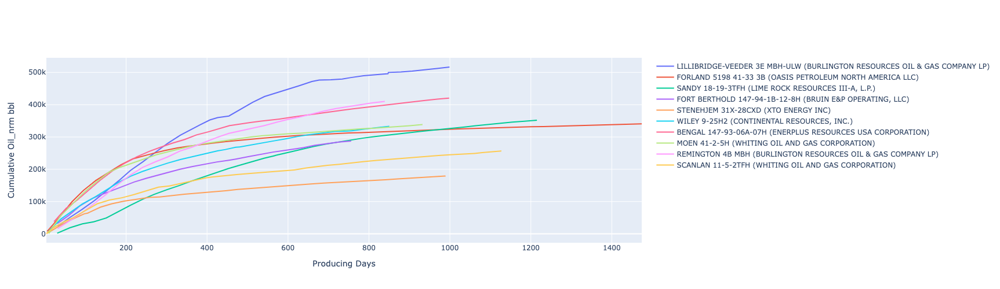

In [26]:
# Subset dataframe
df_head = df_header[(df_header['Vintage_Year'].between(2017,2018))].sample(10)
df_prod = df_production.copy()

# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'Oil_nrm', 
            cumulative = 1, 
            width = 1100, height = 500)

## Oil Rate vs. Time Plot

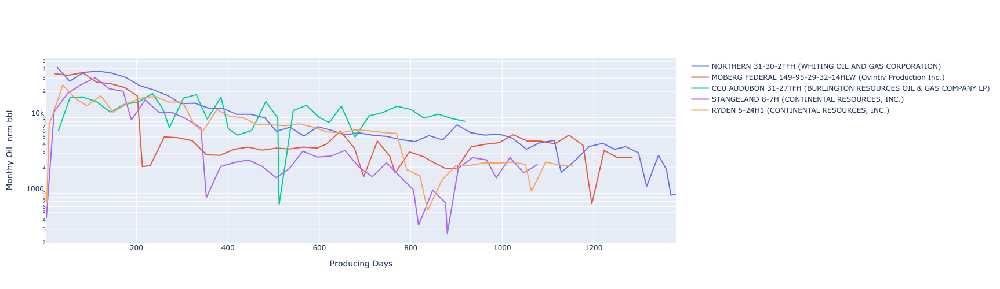

In [15]:
# Subset dataframe
df_head = df_header[(df_header['Vintage_Year'].between(2016,2017))].sample(5)

df_prod = df_production.copy()
# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'Oil_nrm', 
            cumulative = 0, 
            width = 1000, height = 500)

## Oil Rate vs. Cumulative Plot

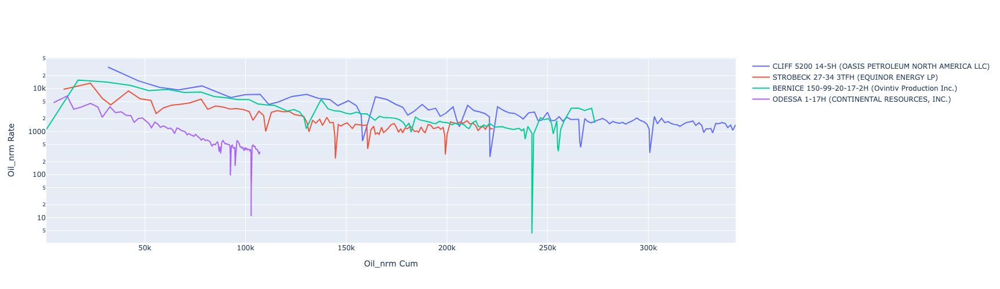

In [28]:
# Subset dataframe
df_head = df_header[(df_header['Vintage_Year'].between(2012,2012))].sample(4)

df_prod = df_production.copy()
# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'Oil_nrm', 
            rate_cum= 1,
            cumulative = 1, 
            width = 1000, height = 500)

## Ratio Plots

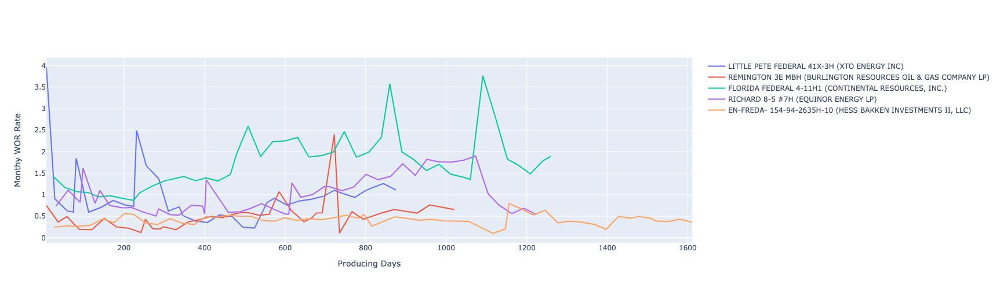

In [30]:
# Subset dataframe
df_head = df_header[(df_header['Vintage_Year'].between(2016,2017))].sample(5)

df_prod = df_production.copy()
# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'WOR', 
            width = 1000, height = 500)

# <center> Average Stream Plots </center>

## Water / Oil Ratio Plot by Vintage

2008-2012 292 wells
2012-2014 387 wells
2014-2016 298 wells
2016-2018 219 wells
2018-2020 208 wells


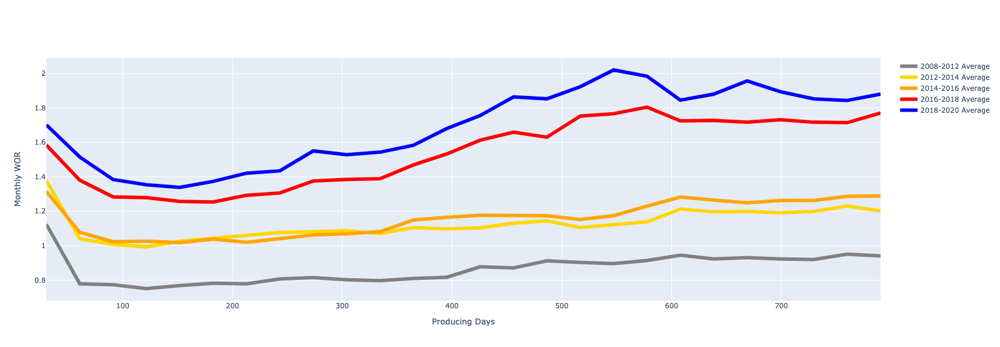

In [18]:
df_head = df_header[df_header['Vintage_Year'] > 2008].sample(1000)
df_prod = df_production[df_production['WOR'].between(0,10)]

# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'WOR', 
            variable = 'Vintage_Year', 
            variable_dict = {'2008-2012':'grey',
                             '2012-2014':'gold',
                             '2014-2016':'orange',
                             '2016-2018':'red',
                             '2018-2020':'blue'},
            averages = 1,
            width = 800, height = 600 )

## Cumulative Oil by Vintage

2008-2012 288 wells
2012-2014 421 wells
2014-2016 289 wells
2016-2018 209 wells
2018-2020 203 wells


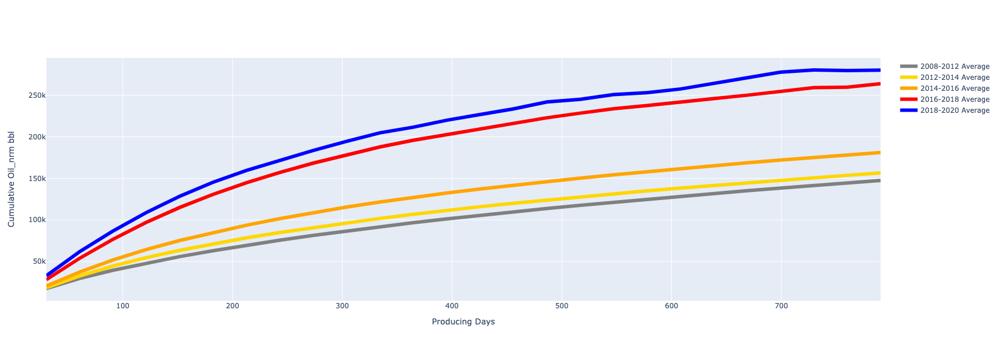

In [19]:
df_head = df_header[df_header['Vintage_Year'] > 2008].sample(1000)
df_prod = df_production[df_production['WOR'].between(0,10)]

# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'Oil_nrm', 
            variable = 'Vintage_Year', 
            variable_dict = {'2008-2012':'grey',
                             '2012-2014':'gold',
                             '2014-2016':'orange',
                             '2016-2018':'red',
                             '2018-2020':'blue'},
            averages = 1,
            width = 800, height = 600 )

## Production by ~Depth / Pressure

0-9000 183 wells
9000-10000 486 wells
10000-11000 1828 wells
11000-12000 2448 wells
12000-13000 66 wells


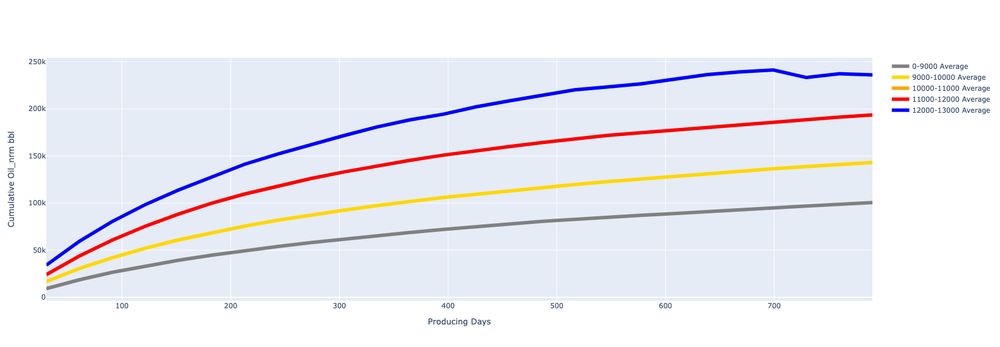

In [20]:
df_head = df_header.sample(5000)
df_prod = df_production.copy()
# ---------------------------------------------------------
STREAM_PLOT(dataframe = df_head, 
            production_dataframe = df_prod, 
            material = 'Oil_nrm', 
            cumulative = 1, 
            variable = 'Top_Perf', 
            variable_dict = {'0-9000':'grey',
                             '9000-10000':'gold',
                             '10000-11000':'orange',
                             '11000-12000':'red',
                             '12000-13000':'blue'},
            averages = 1,
            width = 800, height = 600)